<h1>Activity 1</h1>
<hr>
<h3>Analyst: Elaiza Flores Lim</h3>

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import folium
from folium.plugins import HeatMap

ModuleNotFoundError: No module named 'pandas'

<h1>DATABASE</h1>

In [2]:
chicago_df = pd.read_csv('datasets\\chicago_2001_present.csv')

In [2]:
Chicago_01 = pd.read_csv('Dataset\\Chicago_Crimes.csv')
Chicago_01

NameError: name 'pd' is not defined

In [3]:
Chicago_01.info()

NameError: name 'Chicago_01' is not defined

<H1>FILLING UP NULL VALUES</H1>

In [3]:
chicago_df['Location Description'] = chicago_df['Location Description'].fillna('unaccounted')
chicago_df['District'] = chicago_df['District'].fillna(chicago_df['District'].mean())
chicago_df['Ward'] = chicago_df['Ward'].fillna('unaccounted')
chicago_df['Community Area'] = chicago_df['Community Area'].fillna('unaccounted')
chicago_df['X Coordinate'] = chicago_df['X Coordinate'].fillna('unaccounted')
chicago_df['Y Coordinate'] = chicago_df['Y Coordinate'].fillna('unaccounted')
chicago_df['Location'] = chicago_df['Location'].fillna('unaccounted')
chicago_df = chicago_df.dropna(subset=['Latitude', 'Longitude'])
chicago_df.isnull().sum()

ID                      0
Case Number             0
Date                    0
Block                   0
IUCR                    0
Primary Type            0
Description             0
Location Description    0
Arrest                  0
Domestic                0
Beat                    0
District                0
Ward                    0
Community Area          0
FBI Code                0
X Coordinate            0
Y Coordinate            0
Year                    0
Updated On              0
Latitude                0
Longitude               0
Location                0
dtype: int64

<H1>DATA TYPES</H1>

In [4]:
chicago_df.dtypes

ID                        int64
Case Number              object
Date                     object
Block                    object
IUCR                     object
Primary Type             object
Description              object
Location Description     object
Arrest                     bool
Domestic                   bool
Beat                      int64
District                float64
Ward                     object
Community Area           object
FBI Code                 object
X Coordinate             object
Y Coordinate             object
Year                      int64
Updated On               object
Latitude                float64
Longitude               float64
Location                 object
dtype: object

<H1>Q1 : YEAR 2001  ANALYSIS</H1>

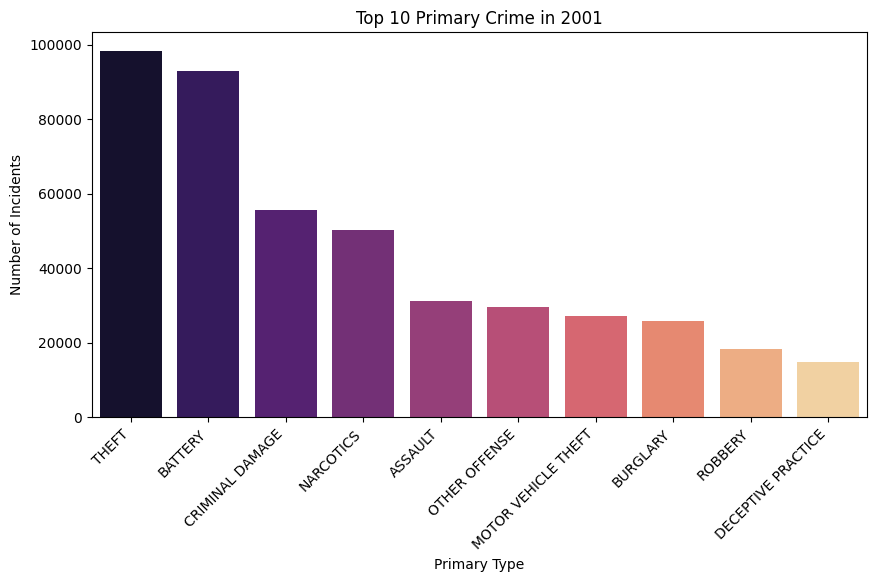

In [5]:
chicago_2001 = chicago_df[chicago_df['Year'] == 2001]
loc_counts = chicago_2001['Primary Type'].value_counts().head(10)
plt.figure(figsize=(10,5))
sns.barplot(x=loc_counts.index, y=loc_counts.values, palette='magma')
plt.title('Top 10 Primary Crime in 2001')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Primary Type')
plt.ylabel('Number of Incidents')
plt.show()

<h1>Insight No 1</h1>
<p>This is the Top 10 Crime in 2001, and theft is clearly number one with nearly 100,000 records, which is surprisingly high. I think widespread poverty and limited economic opportunities pushed many people toward quick, low‑risk ways to make money back then. That sharp lead for theft suggests policy focus should have prioritized social support and targeted prevention to address the root causes rather than only increasing enforcement.</p>

<h1>YEAR 2001 HEATMAP </h1>

In [6]:
locations = list(zip(chicago_2001['Latitude'], chicago_2001['Longitude']))
m = folium.Map(location=[chicago_2001['Latitude'].mean(), chicago_2001['Longitude'].mean()], zoom_start=10)
HeatMap(locations).add_to(m)
m.save('insight_1.html')
m  

<h1>Q2: YEAR 2024 ANALYSIS</h1>

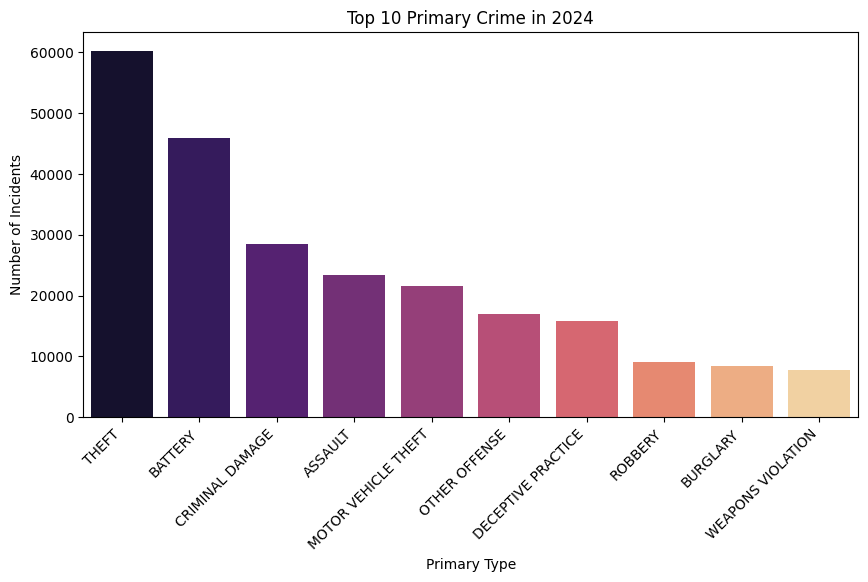

In [7]:
chicago_2024 = chicago_df[chicago_df['Year'] == 2024]
loc_counts = chicago_2024['Primary Type'].value_counts().head(10)
plt.figure(figsize=(10,5))
sns.barplot(x=loc_counts.index, y=loc_counts.values, palette='magma')
plt.title('Top 10 Primary Crime in 2024')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Primary Type')
plt.ylabel('Number of Incidents')
plt.show()

<h1>Insight No 2</h1>
<p>This is the Top 10 Crime in 2024, and theft remains clearly number one with a large lead over other offenses, which is concerning because it shows persistent property‑crime pressure in the city. I think economic stress, opportunistic targets, and gaps in property security contributed to theft’s dominance, while battery and criminal damage being high suggests public‑space conflicts and vandalism were also major problems. The data imply policy should balance enforcement with prevention by improving street and property security, expanding social supports, and targeting hotspots where theft and battery cluster.</p>

<h1>YEAR 2024 HEATMAP</h1>

In [8]:
locations = list(zip(chicago_2024['Latitude'], chicago_2024['Longitude']))
m = folium.Map(location=[chicago_2024['Latitude'].mean(), chicago_2024['Longitude'].mean()], zoom_start=10)
HeatMap(locations).add_to(m)
m.save('insight_2.html')
m  

<H1>Q3: YEAR 2001 KIDNAPPING ANALYSIS</H1>

Total kidnapping rows in 2001: 924


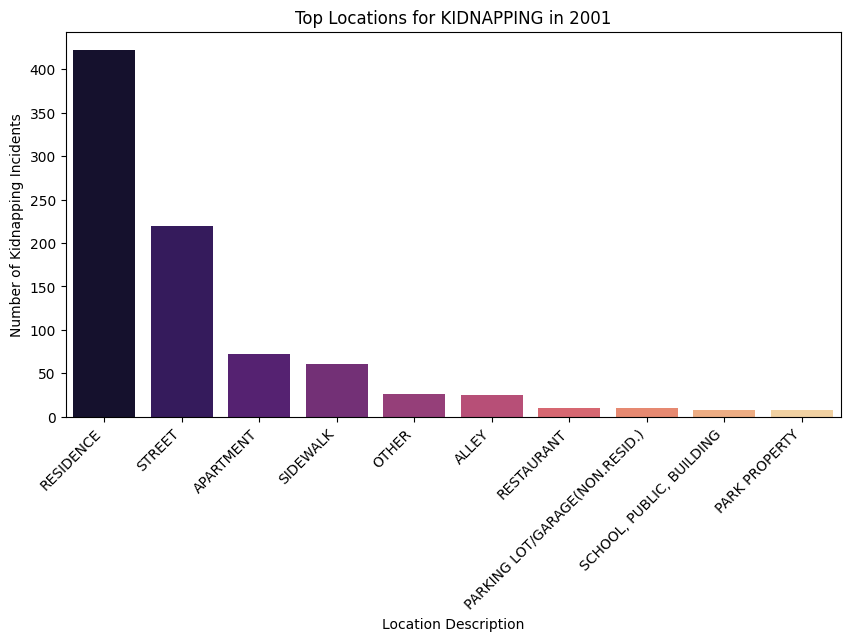

In [9]:
chicago_df_2001 = chicago_df[chicago_df['Year'] == 2001]
kidnapping_df = chicago_df_2001[chicago_df_2001['Primary Type'] == 'KIDNAPPING']

print("Total kidnapping rows in 2001:", len(kidnapping_df))

loc_counts = kidnapping_df['Location Description'].value_counts().head(10)

plt.figure(figsize=(10,5))
sns.barplot(x=loc_counts.index, y=loc_counts.values, palette='magma')
plt.title('Top Locations for KIDNAPPING in 2001')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Location Description')
plt.ylabel('Number of Kidnapping Incidents')
plt.show()

<h2>Insight No 3</h2>
<p>I can see from the year 2001 that kidnapping incidents mostly at residence which surprise me because I thought that our houses are the most secure place. I think that era play a crucial role here because I think that criminal are more notorious back then. Houses usually consist of only few people and so kidnapping at residence back then must be easy compared to crowded spaces.</p> 
<h2>Insight No 4</h2>    
<p>School, public and building are low, one of the factor could be that there are many people and you cannot kidnap someone when there is so many people comparing to few people at residence. It could be maybe that this locations are more guarded with officials compared to residence which only consist of mostly family member</p>

In [4]:
import matplotlib.pyplot as plt

# Filter for 2001 data
chicago_df_2001 = chicago_df[chicago_df['Year'] == 2001]

# Count number of arrests and non-arrests
arrest_counts = chicago_df_2001['Arrest'].value_counts()

# Define red shades
colors = ['red', 'lightcoral']  # You can customize these

# Plot pie chart
plt.pie(arrest_counts,
        labels=arrest_counts.index.map({True: 'Arrested', False: 'Not Arrested'}),
        autopct='%1.1f%%',
        startangle=90,
        colors=colors)

# Improve layout
plt.gcf().set_size_inches(10, 7)
plt.title('Kidnapping Arrest Distribution in Chicago (2001)', color='red')  # Optional: red title
plt.axis('equal')

# Show plot
plt.show()


ModuleNotFoundError: No module named 'matplotlib'

<h1>Insight No 5</h1>
<p>I can see that Kidnap Arrest Distribution during 2001. Seeing 70.8% of kidnapping reports with no arrest makes me uneasy because it suggests most victims don’t see immediate justice. That gap feels like evidence of investigative limits, delayed reporting, or cases happening in ways that make identifying suspects hard. I’d want universities and local groups to push for faster reporting, better coordination with police, and more accessible support so victims aren’t left without follow-up.</p>

<h1>Q4: YEAR 2024 KIDNAPPING ANALYSIS</h1>

<h1>Insight No 6</h1>
<p>This is the year 2024 and if I compare this to year 2001, there are some changes and the most noticable is the decrease in kidnapping with 95 record. We can see now that the top location for kidnapping is now on the street. This is surpring because there is always so many people on the street, so how can someone be kidnap, then I think that it could be mostly at night when only a few people are active. These kidnappers could be a sindikato because if they can pull it.</p>
<h1>Insight No 7</h1>
<p>I also think that people are more dangerous now because we can see that there is a case of kinapping at Church/Synagoguie/Place of Worship, although it is low, that is still a case. These people could be a paid kidnapper because most people that go to these places are good people and they might be waiting to ambush their target</p>

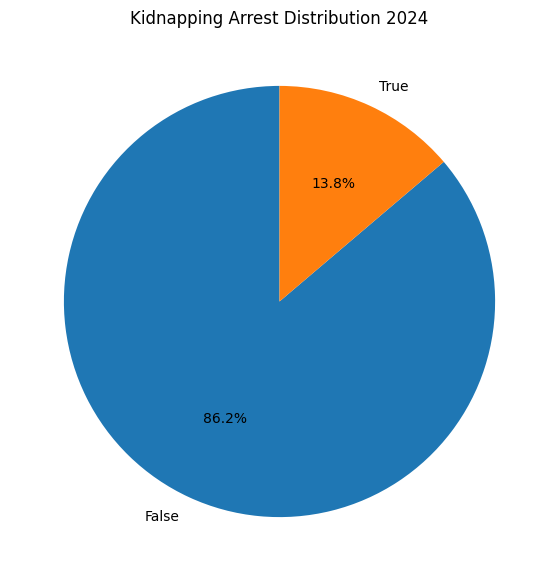

In [13]:
chicago_df_2024 = chicago_df[chicago_df['Year'] == 2024]
arrest_counts = chicago_df_2024['Arrest'].value_counts()

plt.pie(arrest_counts,
        labels = arrest_counts.index,
        autopct = '%1.1f%%',
        startangle = 90,)
plt.gcf().set_size_inches(10,7)
plt.title('Kidnapping Arrest Distribution 2024')
plt.show()

<h1>Insight No 8</h1>
<p>This is the year 2024 with 86.2% and its still the same like in 2001, many suspects or kidnappers dont get caught. Just thinking that these guys are roaming freely is so alarming. I think that government need to invest on cctv around their city to maximize the security of their city and their people. It could be that they have a back plan to escape</p>

<H1>Q5: ARSON ANALYSIS</H1>

<h1>Insight No 9</h1>
<p>I can see that the peak year for ARSON crime is early 2000s and peak at 2001. I think that reason for this could be that the use for wood on these years contribute to being target by arson because wood are weak to fire, so arsonist are more active during these year. The crime continue to decline even last year 2024, one of the reason could be that there is a strong consequence for doing this crime in Chicago</p>

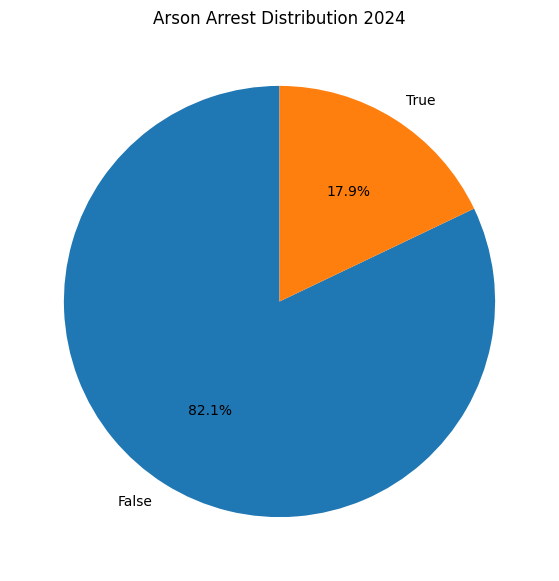

In [16]:
arson_2024 = arson_df[arson_df['Year'] == 2001]
arrest_counts = arson_2024['Arrest'].value_counts()

plt.pie(arrest_counts,
        labels = arrest_counts.index,
        autopct = '%1.1f%%',
        startangle = 90,)
plt.gcf().set_size_inches(10,7)
plt.title('Arson Arrest Distribution 2024')
plt.show()

<h1>Insight No 10</h1>
<p>Seeing 82.1% False and only 17.9% True makes me uneasy because it means almost no reported arson cases led to an arrest. That gap suggests investigations are struggling with evidence, delayed reporting, or resource limits rather than incidents being unimportant. I’d want better rapid-response coordination, improved scene preservation and CCTV coverage, and clearer community reporting channels so victims and witnesses can help investigations succeed.</p>

<h1>Q6: GAMBLING ANALYSIS</h1>

<h1>Insight No 11</h1>
<p>I can see that gambling peak during the year 2007, but continued to decline in present. One of the reason for the decline could be that strcict of implementation of law againts gambling in Chicago. Although in 2001 it was lower and continue to rise until 2007, it can suggest that people there was influenced by something like drug addict.This sharp and sustained drop suggests that stricter law enforcement and policy changes were highly effective in curbing visible gambling activity.</p>

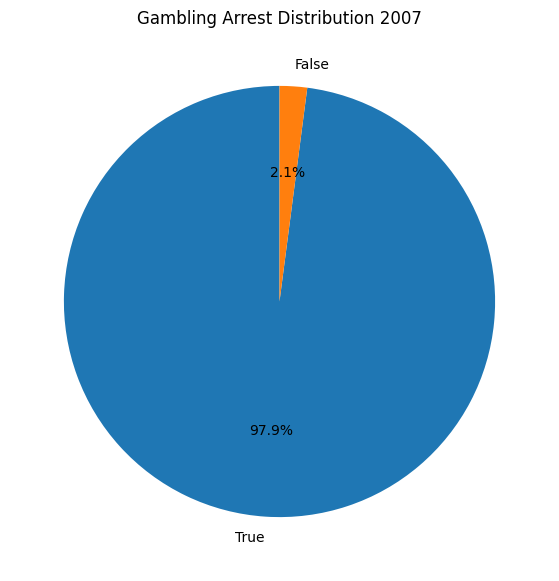

In [19]:
gambling_2007 = gambling_df[gambling_df['Year'] == 2007]
arrest_counts = gambling_2007['Arrest'].value_counts()

plt.pie(arrest_counts,
        labels = arrest_counts.index,
        autopct = '%1.1f%%',
        startangle = 90,)
plt.gcf().set_size_inches(10,7)
plt.title('Gambling Arrest Distribution 2007')
plt.show()

<h1>Insight No 12</h1>
<p>Seeing 97.9% True and only 2.1% False makes me think enforcement was really active and effective that year. That high true rate suggests police were either targeting visible gambling operations or had strong evidence during sweeps. This overwhelming skew suggests that enforcement during that year was highly targeted and effective—officers were making arrests in situations where evidence was strong, leaving very little room for dismissals or misclassification. It reflects a period of strict crackdowns where gambling cases were pursued with high certainty.</p>

<h1>Insight No 13</h1>
<p>I’m seeing the numbers drop a lot since the mid‑2000s, which makes me think something changed in how cases are handled or moved online rather than the problem completely disappearing. From an IT student view, it could be that activity migrated to apps and hidden platforms, so basic street counts don’t tell the whole story. This long-term decline suggests a major shift likely due to stricter law enforcement, policy changes, and possibly the movement of prostitution into less visible or online spaces rather than public streets.</p>

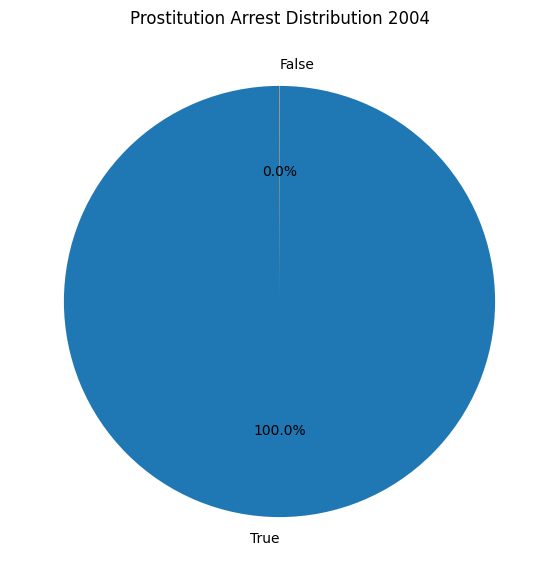

In [22]:
prostitution_2004 = prostitution_df[prostitution_df['Year'] == 2004]
arrest_counts = prostitution_2004['Arrest'].value_counts()
plt.pie(arrest_counts,
        labels = arrest_counts.index,
        autopct = '%1.1f%%',
        startangle = 90,)
plt.gcf().set_size_inches(10,7)
plt.title('Prostitution Arrest Distribution 2004')
plt.show()

<h1>Insight No 14</h1>
<p>There is 100% arrest rate for prostitution during the year 2007, It could be because there was no such law that forbic this kind of work or that it was influence by financial of the sex workers.his perfect distribution suggests that enforcement during that year was extremely targeted, with police acting only in cases where evidence was strong and charges were certain to hold. It reflects a period of very strict and decisive policing around prostitution-related activity. But I am surprised that the arrest rate is 100% because I think that they are only working</p>

<h1>Q8: HOMICIDE ANALYSIS</h1>

<h1>Insight No 15</h1>
<p>I can see that Homicide peak at 2021 which is surprising because that is almost on COVID 19 and I thought that It will be the lowest when there strict implementation on lockdown. It continued to decrease until now 2025 which is good suggesting that maybe Chicago had a stricier policy now than before</p>

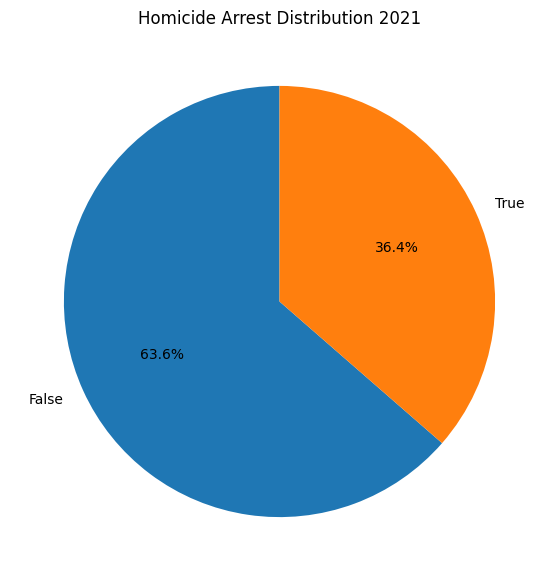

In [25]:
homicide_2021 = homicide_df[homicide_df['Year'] == 2021]
arrest_counts = homicide_2021['Arrest'].value_counts()
plt.pie(arrest_counts,
        labels = arrest_counts.index,
        autopct = '%1.1f%%',
        startangle = 90,)
plt.gcf().set_size_inches(10,7)
plt.title('Homicide Arrest Distribution 2021')
plt.show()

<h1>Insight No 16</h1>
<p>This is sad beacuse Homicide is killing someone and the percentage of not being charged by the crime is 63.6% which is higher compared to 36.4% that is arrested. From a student perspective, that’s unsettling because it highlights how many families never see justice and how much trust in the system can be shaken when most cases don’t lead to accountability. This is alarming to all people beacuse a killer can escape the cruelty he did and is roaming freely and that its possible that will commit murder again.</p>

<h1>Q9: STALKING ANALYSIS</h1>

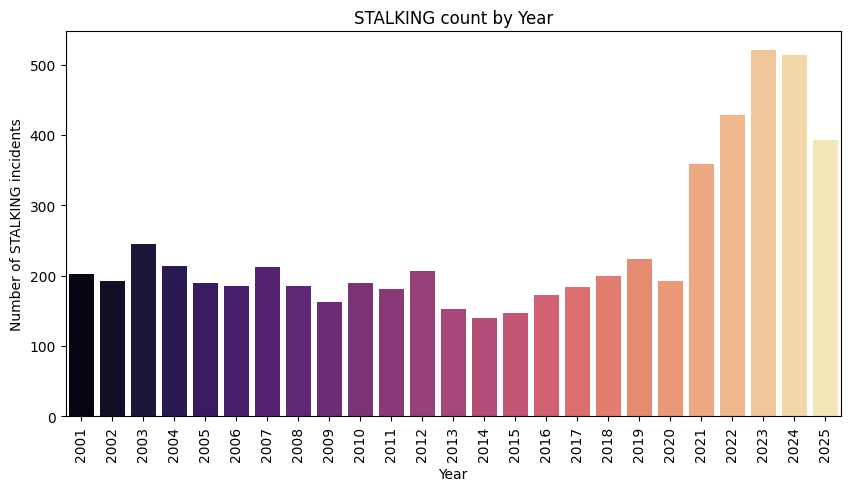

In [27]:
stalking_df = chicago_df[chicago_df['Primary Type'] == 'STALKING'].copy()

year_counts = stalking_df['Year'].value_counts().reset_index()
year_counts.columns = ['Year', 'Count']
year_counts = year_counts.sort_values('Year')

plt.figure(figsize=(10,5))
sns.barplot(data=year_counts, x='Year', y='Count', palette='magma')
plt.xlabel('Year')
plt.ylabel('Number of STALKING incidents')
plt.title('STALKING count by Year')
plt.xticks(rotation=90)
plt.show()

<h1>Insight No 17</h1>
<p>The steady rise in stalking since about 2015, with a sharp jump through 2018–2023, makes me uneasy because it suggests this is becoming more common and not just random fluctuation. It feels likely that social media, dating apps, and easier digital access to personal information are amplifying opportunities for stalking, so the increase may be both online and offline. I think that we need to be more cautiuos, universities and local authorities to prioritize awareness, stronger reporting channels, and digital safety training so students know how to protect themselves and where to get help.</p>

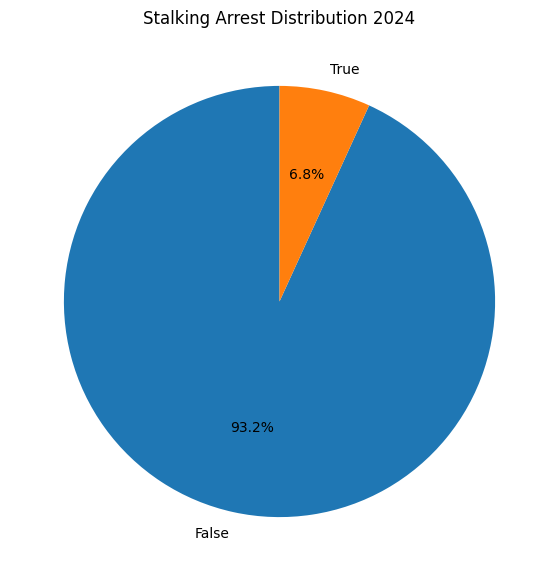

In [28]:
stalking_2024 = stalking_df[stalking_df['Year'] == 2024]
arrest_counts = stalking_2024['Arrest'].value_counts()
plt.pie(arrest_counts,
        labels = arrest_counts.index,
        autopct = '%1.1f%%',
        startangle = 90,)
plt.gcf().set_size_inches(10,7)
plt.title('Stalking Arrest Distribution 2024')
plt.show()

<h1>Insight No 18</h1>
<p>This is just last year 2024, stalking is not really that dangerous unless the mind of stalker becomes so corrupted like wanting to do some crazy things. I think that we should be more private and keep our information secret so that stalkers dont have any info about us. 93.2% are not being arrested and avoid being in jail so they`re still roaming freely and dangerous to the people. I think that we should be more strict to these crime.</p>

<h1>YEAR 2001-2025 STALKING HEATMAP</h1>

In [29]:
locations = list(zip(stalking_df['Latitude'], stalking_df['Longitude']))
m = folium.Map(location=[stalking_df['Latitude'].mean(), stalking_df['Longitude'].mean()], zoom_start=10)
HeatMap(locations).add_to(m)
m.save('insight_16-18.html')
m

<h1>Q10: HUMAN TRAFFICKING ANALYSIS</h1>

Total trafficking row is: 119


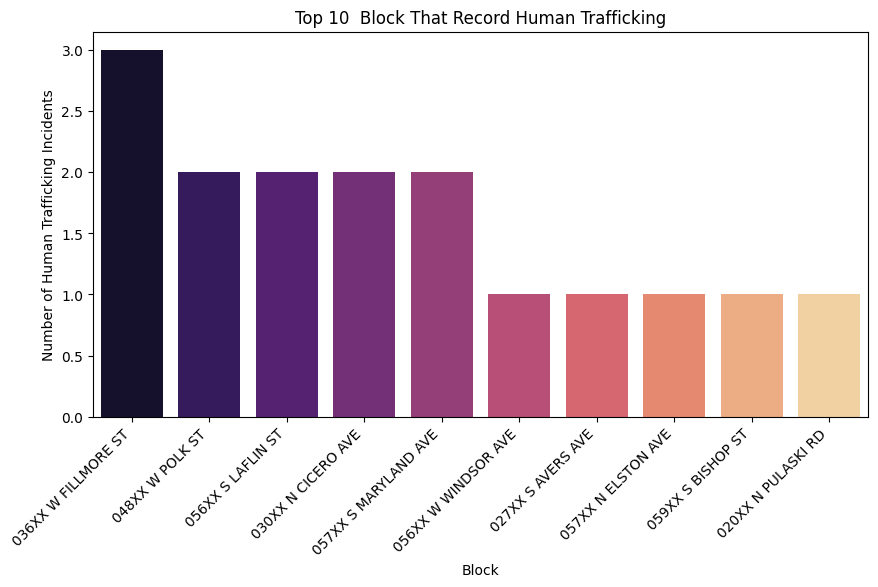

In [30]:
trafficking_df = chicago_df[chicago_df['Primary Type'] == 'HUMAN TRAFFICKING']

print("Total trafficking row is:", len(trafficking_df))

loc_counts = trafficking_df['Block'].value_counts().head(10)

plt.figure(figsize=(10,5))
sns.barplot(x=loc_counts.index, y=loc_counts.values, palette='magma')
plt.title('Top 10  Block That Record Human Trafficking')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Block')
plt.ylabel('Number of Human Trafficking Incidents')
plt.show()


<h1>Insight No 19</h1>
<p>Seeing that 036XX W FILLMORE ST tops the chart for human trafficking incidents makes me think something serious is happening in that area, even if the numbers look small. As a student, I’d want to know whether these are repeat cases or if the same location keeps getting flagged because of poor surveillance or lack of community reporting. It’s unsettling to think this could be happening near residential blocks, so I think that I  push for more awareness campaigns, better lighting, and stronger local partnerships to help people spot and report suspicious activity.</p>

<h1>Insight No 20</h1>
<p>It’s disturbing to see 044XX W SIMMONS DR and 004XX S STATE ST topping the list with nearly 80 sex offense incidents each—those aren’t just numbers, they point to real safety concerns in specific areas. From my perspective, this feels like a reminder that crime isn’t evenly spread across a city—it concentrates in specific places. That means prevention strategies like better lighting, community patrols, or targeted outreach could be most effective if focused on these few high risk blocks rather than spread thin everywhere.</p>

<h1>SEX OFFENSE HEATMAP</h1>

In [33]:
locations = list(zip(sex_df['Latitude'], sex_df['Longitude']))
m = folium.Map(location=[sex_df['Latitude'].mean(), sex_df['Longitude'].mean()], zoom_start=10)
HeatMap(locations).add_to(m)
m.save('insight_20.html')
m

<h1>Q12: CRIM SEXUAL ASSAULT VS SEX OFFESE ANALYSIS</h1>

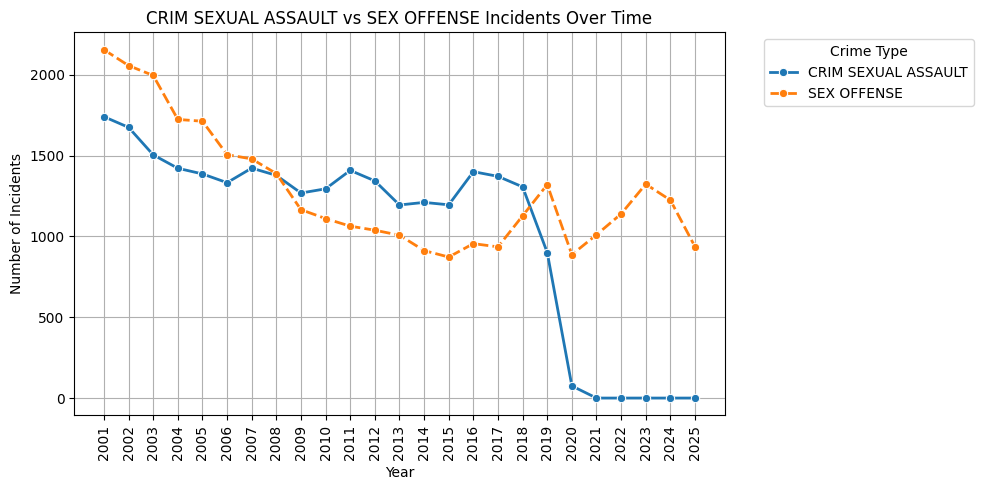

In [34]:
selected_types = ['CRIM SEXUAL ASSAULT', 'SEX OFFENSE']
filtered_df = chicago_df[chicago_df['Primary Type'].isin(selected_types)]

grouped = filtered_df.groupby(['Year', 'Primary Type']).size().reset_index(name='Count')
pivoted = grouped.pivot(index='Year', columns='Primary Type', values='Count').fillna(0)

plt.figure(figsize=(10,5))
sns.lineplot(data=pivoted, linewidth=2, marker='o')
plt.title('CRIM SEXUAL ASSAULT vs SEX OFFENSE Incidents Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.xticks(range(2001,2026), rotation=90)
plt.grid(True)
plt.legend(title='Crime Type',bbox_to_anchor = (1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

<h1>Insight No 21</h1>
<p>I can see that CRIM SEXUAL ASSAULT continue to decrease from 2019 until now and that is good for me but the SEX OFFENSE are still so high with almost 1250 cases last 2024. Although its 2025 right now with almost 1000 record its still alarming because its still happening. What I can suggest is that people should be wary of other people or strangers to avoid being sex offended.</p>

<h1>Q13: PUBLIC PEACE VIOLATION VS DECEPTIVE PRACTICE</h1>

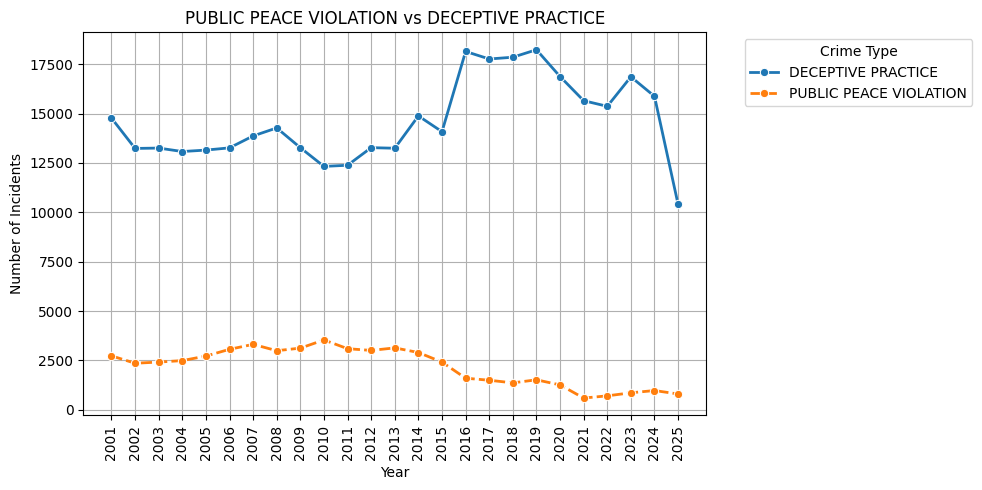

In [35]:
selected_types = ['PUBLIC PEACE VIOLATION', 'DECEPTIVE PRACTICE']
filtered_df = chicago_df[chicago_df['Primary Type'].isin(selected_types)]

grouped = filtered_df.groupby(['Year', 'Primary Type']).size().reset_index(name='Count')
pivoted = grouped.pivot(index='Year', columns='Primary Type', values='Count').fillna(0)

plt.figure(figsize=(10,5))
sns.lineplot(data=pivoted, linewidth=2, marker='o')
plt.title('PUBLIC PEACE VIOLATION vs DECEPTIVE PRACTICE')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.xticks(range(2001,2026), rotation=90)
plt.grid(True)
plt.legend(title='Crime Type',bbox_to_anchor = (1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

<h1>Insight No 22</h1>
<p>The line graph makes it clear that Deceptive Practice (like fraud, scams, or forgery) has historically been far more common than Public Peace Violations, peaking around 2011–2012 with nearly 18,000 cases before steadily declining after 2019. In contrast, Public Peace Violations remain consistently low generally under 3,000 incidents showing that they’re a much smaller share of overall crime. From my perspective, this suggests that financial or fraud related crimes were once a major urban concern but have since been reduced, while public order issues remain steady, highlighting how crime priorities and enforcement can shift over time.</p>

<h1>Q14: OBSCENITY VS PUBLIC INDECENCY ANALYSIS</h1>

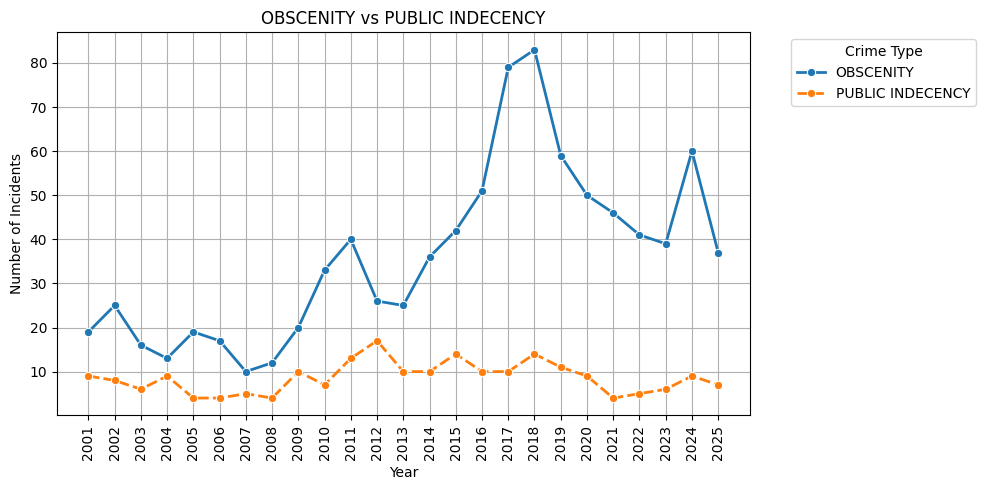

In [36]:
selected_types = ['OBSCENITY', 'PUBLIC INDECENCY']
filtered_df = chicago_df[chicago_df['Primary Type'].isin(selected_types)]

grouped = filtered_df.groupby(['Year', 'Primary Type']).size().reset_index(name='Count')
pivoted = grouped.pivot(index='Year', columns='Primary Type', values='Count').fillna(0)

plt.figure(figsize=(10,5))
sns.lineplot(data=pivoted, linewidth=2, marker='o')
plt.title('OBSCENITY vs PUBLIC INDECENCY')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.xticks(range(2001,2026), rotation=90)
plt.grid(True)
plt.legend(title='Crime Type',bbox_to_anchor = (1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

<h1>Insight No 23</h1>
<p>I can see that Obscenity incidents swing dramatically over the years, with a major spike around 2016 (over 80 cases) and another rise near 2020, while Public Indecency stays consistently low, usually between 5 20 cases. This contrast suggests that obscenity is more sensitive to social or enforcement shifts, while public indecency remains a small but steady issue.
</p>
<h1>Insight No 24</h1>
<p>The sharp rise in obscenity cases around 2016 and again near 2020 may reflect policy crackdowns, cultural shifts, or heightened reporting during those years. The fact that numbers drop again afterward shows how responsive this category is to external factors, unlike the stable baseline of public indecency.</p>

<h1>Q15: WEAPONS VIOLATION VS ASSAULT</h1>

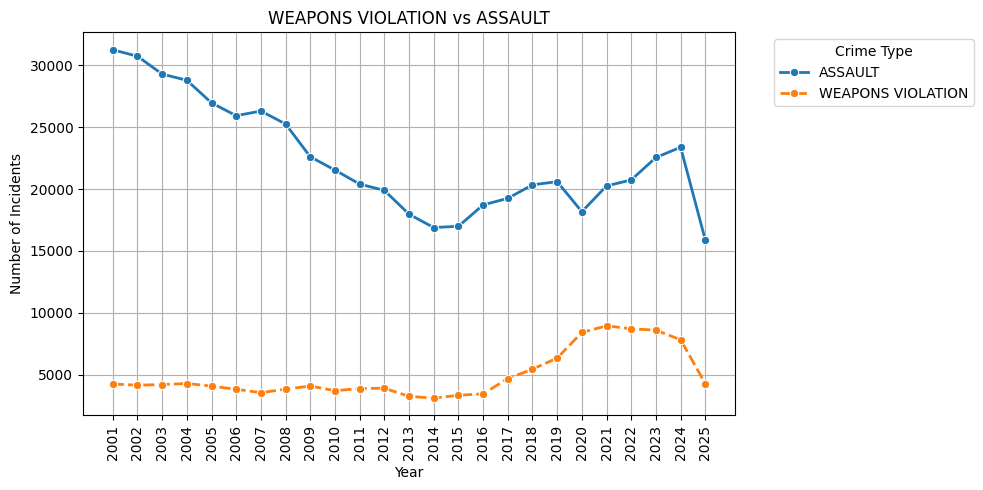

In [37]:
selected_types = ['WEAPONS VIOLATION', 'ASSAULT']
filtered_df = chicago_df[chicago_df['Primary Type'].isin(selected_types)]

grouped = filtered_df.groupby(['Year', 'Primary Type']).size().reset_index(name='Count')
pivoted = grouped.pivot(index='Year', columns='Primary Type', values='Count').fillna(0)

plt.figure(figsize=(10,5))
sns.lineplot(data=pivoted, linewidth=2, marker='o')
plt.title('WEAPONS VIOLATION vs ASSAULT')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.xticks(range(2001,2026), rotation=90)
plt.grid(True)
plt.legend(title='Crime Type',bbox_to_anchor = (1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

<h1>Insight No 25</h1>
<p>Assault incidents start very high in the early 2000s (over 30,000 cases) and gradually decline until around 2014, then fluctuate before dropping sharply again in 2024. In contrast, Weapons Violations stay relatively low until about 2015, then rise steadily to a peak around 2021 before declining suggesting a shift in enforcement focus or changes in weapon related activity. I think that people are now carrying more gun for their safety.</p>
<h1>Insight No 26</h1>
<p>While Assault remains the more common crime overall, the rise in Weapons Violations after 2015 narrows the gap between the two categories. This could indicate that although interpersonal violence (assault) has been decreasing, concerns about weapons possession and use have grown, making it a more prominent issue in recent years. Because its now legal to own a gun and of course it will cause accident if people use it wrongly</p>

<h1>Q16: HOTEL/MOTEL vs RESIDENCE vs SIDEWALK vs APARTMENT vs WAREHOUSE ANALYSIS</h1>

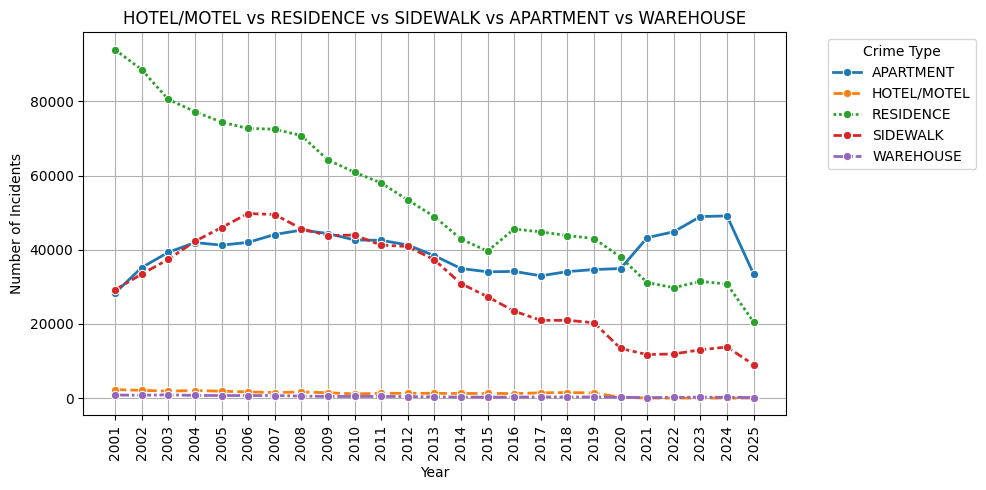

In [38]:
selected_types = ['HOTEL/MOTEL', 'RESIDENCE', 'SIDEWALK', 'APARTMENT', 'WAREHOUSE']
filtered_df = chicago_df[chicago_df['Location Description'].isin(selected_types)]

grouped = filtered_df.groupby(['Year', 'Location Description']).size().reset_index(name='Count')
pivoted = grouped.pivot(index='Year', columns='Location Description', values='Count').fillna(0)

plt.figure(figsize=(10,5))
sns.lineplot(data=pivoted, linewidth=2, marker='o')
plt.title('HOTEL/MOTEL vs RESIDENCE vs SIDEWALK vs APARTMENT vs WAREHOUSE')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.xticks(range(2001,2026), rotation=90)
plt.grid(True)
plt.legend(title='Crime Type',bbox_to_anchor = (1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

<h1>Insight No  27 </h1>
<p>Residential locations consistently record the highest number of incidents, peaking in the early 2000s and then gradually declining. This suggests that while homes remain the most  over the years. One of the reason for the decline is I think that people are now more securing their home againt threats and installing CCTV on their home now</p>
<h1>Insight No 28</h1>
<p>Unlike residences, apartment-related incidents show an upward trend, especially after 2017. This could reflect urban density changes, more multi-unit housing, or better reporting of crimes in apartment complexes. I think that apartment is dangerous too if you are a foreigner on that place or new, people will try to take adavantage of new people</p>
<h1>Insight No 29</h1>
<p>Motel and Warehouse incidents stay consistently low. This contrast highlights how everyday public spaces (like sidewalks) maintain steady exposure to crime, while specialized or less-populated locations see far fewer incidents. Sidewalks are more safely now because people are now aware of the danger and there is also police patrolling now the before</p>

<h1>Q17: SIDEWALK vs STREET vs ALLEY vs BAR OR TAVERN vs CEMETARY ANALYSIS</h1>

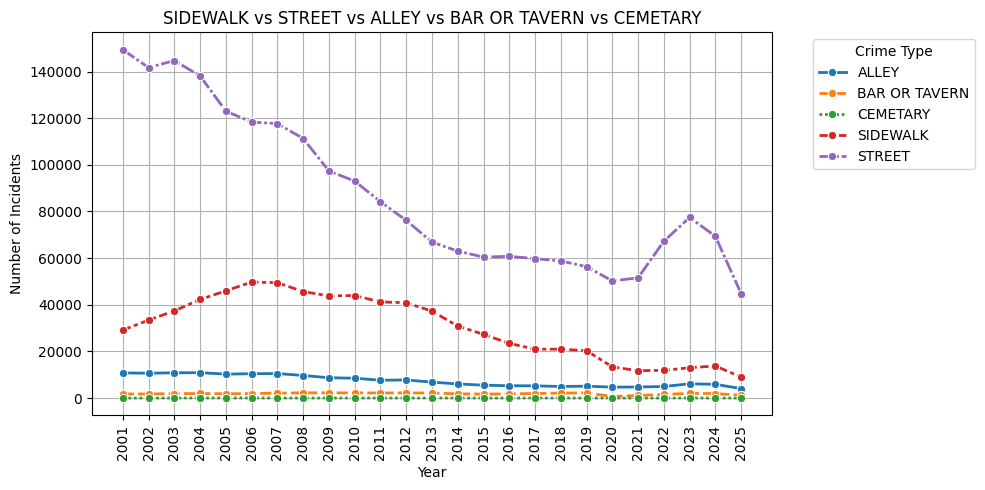

In [39]:
selected_types = ['SIDEWALK', 'STREET', 'ALLEY', 'BAR OR TAVERN', 'CEMETARY']
filtered_df = chicago_df[chicago_df['Location Description'].isin(selected_types)]

grouped = filtered_df.groupby(['Year', 'Location Description']).size().reset_index(name='Count')
pivoted = grouped.pivot(index='Year', columns='Location Description', values='Count').fillna(0)

plt.figure(figsize=(10,5))
sns.lineplot(data=pivoted, linewidth=2, marker='o')
plt.title('SIDEWALK vs STREET vs ALLEY vs BAR OR TAVERN vs CEMETARY')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.xticks(range(2001,2026), rotation=90)
plt.grid(True)
plt.legend(title='Crime Type',bbox_to_anchor = (1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

<h1>Insight No 30</h1>
<p>Sshows that streets remain the most exposed and vulnerable public spaces for crime, though interventions over time may have reduced the numbers. I think that since its a street, Some people are just wandering and without knowing anything, they will stumble upon accidents.</p>
<h1>Insight No 31</h1>
<p>Crime incidents on sidewalks peaked around 2007 before entering a period of gradual decline. Despite this decrease, sidewalks have remained the second most common location for reported offenses. This trend underscores the ongoing vulnerability of pedestrian-heavy areas, where crimes such as theft, assault, and public disturbances are more likely to occur. One contributing factor may be the tendency</p>
<h1>Insight No 32</h1>
<p> cemeteries consistently record far fewer crime incidents and remain relatively stable over time. Their low numbers should not be interpreted as being risk-free, but rather as indicative of the less frequent and more situational nature of crime in these areas. This lower frequency is likely due to the fact that people visit these locations less often compared to more commonly used public spaces such as streets and sidewalks. With fewer individuals present, there are simply fewer opportunities for crimes to occur. In contrast, areas with high foot traffic experience more consistent exposure, increasing both the likelihood of criminal activity and the chances of it being reported.</p>

<h1>Q18: SCHOOL - PUBLIC GROUNDS vs SCHOOL - PUBLIC BUILDING vs SCHOOL - PRIVATE GROUNDS vs SCHOOL - PRIVATE BUILDING vs SCHOOL YARD ANALYSIS</h1>

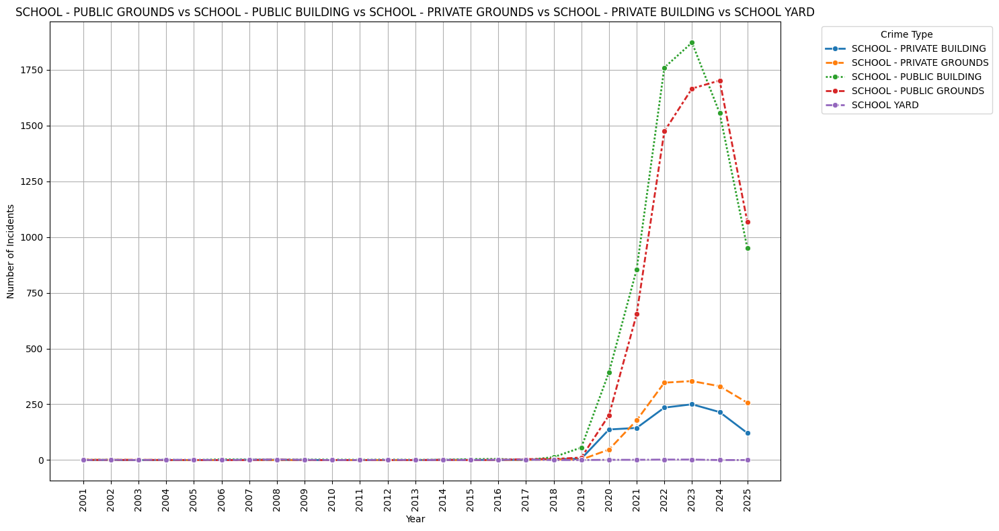

In [40]:
selected_types = ['SCHOOL - PUBLIC GROUNDS', 'SCHOOL - PUBLIC BUILDING', 'SCHOOL - PRIVATE GROUNDS', 'SCHOOL - PRIVATE BUILDING', 'SCHOOL YARD']
filtered_df = chicago_df[chicago_df['Location Description'].isin(selected_types)]

grouped = filtered_df.groupby(['Year', 'Location Description']).size().reset_index(name='Count')
pivoted = grouped.pivot(index='Year', columns='Location Description', values='Count').fillna(0)

plt.figure(figsize=(15,8))
sns.lineplot(data=pivoted, linewidth=2, marker='o')
plt.title('SCHOOL - PUBLIC GROUNDS vs SCHOOL - PUBLIC BUILDING vs SCHOOL - PRIVATE GROUNDS vs SCHOOL - PRIVATE BUILDING vs SCHOOL YARD')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.xticks(range(2001,2026), rotation=90)
plt.grid(True)
plt.legend(title='Crime Type',bbox_to_anchor = (1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

<h1>Insight No 33</h1>
<p>All school related categories (public/private buildings, grounds, and yards) show a noticeable surge starting around 2016, peaking in 2021. This suggests either a real increase in incidents or a shift in reporting practices and classification. One of the reason that I think is because students are more prone to danger now, they can easily track by social media or anything that has tied with them that can be use againts them.</p>
<h1>Insight No 34</h1>
<p>School  Public Grounds consistently records the highest number of incidents, surpassing 1,700 at its peak. This makes sense since public grounds (like playgrounds, fields, or open areas) are more accessible and harder to monitor compared to buildings. I think that one of the factor in this surge are that there is more student at public school compared to private school that contribute to number of record incidents.</p>
<h1>Insight No 35</h1>
<p>By 2023, incidents across all categories slightly decline or level off, hinting at possible interventions (like security upgrades, awareness campaigns, or policy changes) that may have curbed the upward trend. I think that the government in Chicago already saw this data ang provide the best possible way to decreace the incident that is happenig. Data driven decision are realy the best way to make solution to problems and I think this is true</p>